In [49]:
include("Harvey_in_Nelson_funcs.jl")
using .julia


In [50]:
using LinearAlgebra
using Random
using Distributions
using ProgressMeter
using Statistics  
using SpecialFunctions
using NLopt

using Plots
using StatsPlots  
using DataFrames
using XLSX


## Estimate

In [51]:
# Specify the file path and sheet name
file_path = "quarterly_gdp.xlsx"
sheet_name = "Quarterly GDP"

# Open the Excel file and load the data from the specified sheet into a DataFrame
data = XLSX.readtable(file_path, sheet_name) |> DataFrame

# Display data
println(data)

# Get the number of observations
num_obs = size(data, 1)
println("Number of observations: ", num_obs)




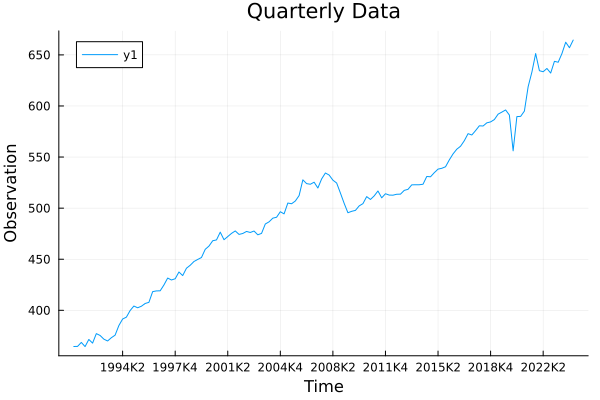

In [52]:
y = data[:, 2]
# y = log.(y)
dates = data[:, 1]

# Plot the data
plot(dates,y, title="Quarterly Data", xlabel="Time", ylabel="Observation")

In [53]:
#Define model
n_order = 2
state_dim = 2+2*n_order
alpha_init = zeros(state_dim)
alpha_init[1] = y[1]
P1 = Matrix{Float64}(I(state_dim))*100  # Initial covariance matrix

#Priors

a_rho = 0.01
b_rho = 0.97

a_lambda = 0.01
b_lambda = π

a_xi = 1e-6
b_xi = 1e6

a_kappa_0 = 1e-6
b_kappa_0 = 1e6

a_kappa_1 = 1e-6
b_kappa_1 = 1e6

a_epsilon_0 = 1e-6
b_epsilon_0 = 1e6

a_epsilon_1 = 1e-6
b_epsilon_1 = 1e6

a_omega = -100
b_omega = 100

a_p = 0.01
b_p = 0.99

a_q = 0.01
b_q = 0.99

# a_sigma = 1e-6
# b_sigma = 1e-6

priors = [a_rho, b_rho, a_lambda, b_lambda, a_xi, b_xi, a_kappa_0, b_kappa_0, a_kappa_1, b_kappa_1, a_epsilon_0, b_epsilon_0, a_epsilon_1, b_epsilon_1, a_omega, b_omega, a_p, b_p, a_q, b_q]




20-element Vector{Float64}:
    0.01
    0.97
    0.01
    3.141592653589793
    1.0e-6
    1.0e6
    1.0e-6
    1.0e6
    1.0e-6
    1.0e6
    1.0e-6
    1.0e6
    1.0e-6
    1.0e6
 -100.0
  100.0
    0.01
    0.99
    0.01
    0.99

In [54]:
# Run MCMC initialization
chain_init_burned, Sigma, acceptance_rate_init, chain_init, theta_samples_init = initialize_mcmc(
    y,
    priors,
    alpha_init, 
    P1, 
    n_order; 
    n_init=80000, 
    burn_init=40000, 
    omega_init=0.08)

([-3.2287038590567687 -0.0071668849323614225 … -0.43721737993899323 3.0653385910099376; -3.32251571505424 -0.205148302481121 … -0.5305244293029333 3.137309129602549; … ; -2.1256671214204386 -1.1192767509255224 … -0.8694334888484114 4.899061610856059; -2.1740475746276946 -1.4880960707668796 … -0.5336963251243616 5.147825975090874], [0.98922958766 -0.21635040109390957 … -0.3410553288076367 -0.000310182246004741; -0.21635040109390957 2.252007826350056 … 0.42202221075417484 0.13003112782642468; … ; -0.3410553288076367 0.42202221075417484 … 2.974987236054597 -0.046031706014823905; -0.000310182246004741 0.13003112782642468 … -0.046031706014823905 1.0395752747615954], 0.41015, [0.22861835014752202 -0.3173700317882117 … -0.3077946762468384 0.19905291379369122; 0.22861835014752202 -0.3173700317882117 … -0.3077946762468384 0.19905291379369122; … ; -2.1256671214204386 -1.1192767509255224 … -0.8694334888484114 4.899061610856059; -2.1740475746276946 -1.4880960707668796 … -0.5336963251243616 5.14782

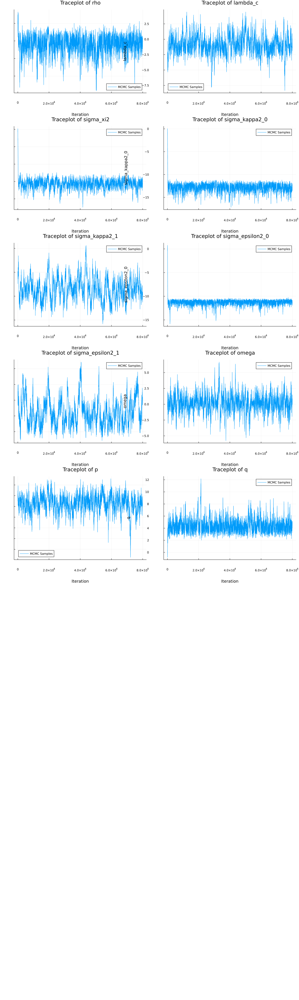

In [55]:
parameters = ["rho", "lambda_c", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

n_params = length(parameters)

# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    param_samples_init = chain_init[:, i]
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples_init, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")

    
    # Add plots to the list
    push!(p_list, p2)
end

# Display the plots 
nrows = n_params
ncols = 2
plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))


In [56]:
# Run MCMC recursion
theta_samples_burned, alpha_samples, acceptance_rate_rec, p_res = recursion_mcmc(
    y, 
    priors,
    alpha_init, 
    P1, 
    n_order, 
    chain_init_burned,
    Sigma; 
    n_rec=40000, 
    burn_rec=20000, 
    omega_rec=0.03)


([0.04948154645660596 0.20563036795411707 … 0.04033750092416431 0.9766804156440813; 0.04948154645660596 0.20563036795411707 … 0.04033750092416431 0.9766804156440813; … ; 0.025192396553238062 1.7572886089613577 … 0.08498598652485065 0.9681529824506869; 0.0241979053331704 1.5303286441285429 … 0.07017605196527546 0.9725124668349284], Any[[364.6 0.0 … 0.0 0.0; 364.70388825846277 0.04872073314640789 … -0.00388825846282863 0.012442184060511573; … ; 657.4244501687707 3.032915250295859 … -0.42445016877089226 -0.024675868753814313; 664.3068010789897 3.2549259310825933 … 0.19319892101039607 0.09419027074193317], [364.6000000000001 0.0 … 0.0 0.0; 364.7040173307487 0.04857280211370777 … -0.00401733074876212 0.008293934096591182; … ; 657.3419678567234 3.2778385753580723 … -0.34196785672353724 -0.009047098576163018; 664.3654492420306 3.5143529863984675 … 0.13455075796943064 0.0487664356652438], [364.6000000000001 0.0 … 0.0 0.0; 364.7040173307487 0.04857280211370777 … -0.00401733074876212 0.008293934

In [57]:
parameters = ["rho", "lambda_c", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

n_params = length(parameters)

10

In [58]:


# Number of optimization runs
num_runs = 1

# Parameter names to associate with priors
parameters = ["rho", "lambda_c", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

upper_bounds = [1.0, π, Inf, Inf, Inf, Inf, Inf, Inf, 1.0, 1.0]
lower_bounds = [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -Inf, 0.0, 0.0]

              
# Function to generate initial parameters from specified priors
function draw_initial_params(parameters)
    initial_params = Float64[]  # Enforce Float64 type for the parameters
    for param in parameters
        if param == "rho"
            push!(initial_params, rand(Uniform(a_rho, b_rho)))
        elseif param == "lambda_c"
            push!(initial_params, rand(Uniform(a_lambda, b_lambda)))
        elseif param in ["p", "q"]
            # Uniform prior between 0 and 1
            push!(initial_params, rand(Uniform(a_p, b_p)))
        elseif param == "omega"
            # Normal prior
            push!(initial_params, rand(Normal(-10, 1)))
        else
            # Inverse-Gamma prior
            push!(initial_params, rand(InverseGamma(3, 1)))
        end
    end
    return initial_params
end

# Define the objective function
function obj(params::Vector, grad::Vector)
    try
        return neg_log_likelihood(params, y, alpha_init, P1, n_order)
    catch e
        return 1e10  # Return a large number in case of error
    end
end

# Run optimization with multiple initial guesses

best_minf = Inf
best_params = nothing

pb = Progress(num_runs; desc="MLE Optimization")
for run in 1:num_runs
    
    # Draw a new set of initial parameters from priors
    initial_params = draw_initial_params(parameters)

    # Create the optimizer
    opt = Opt(:LN_NELDERMEAD, length(initial_params))
    opt.lower_bounds = lower_bounds
    opt.upper_bounds = upper_bounds
    opt.min_objective = obj
    opt.maxeval = 100000
    opt.xtol_rel = 1e-6

    # Run the optimization
    (minf, estimated_params, ret) = NLopt.optimize(opt, initial_params)
 
    # Save the best result
    if minf < best_minf
        best_minf = minf
        best_params = estimated_params
    end

    next!(pb)
end


# Display the best estimated parameters
println("Best Estimated Parameters: ", best_params)


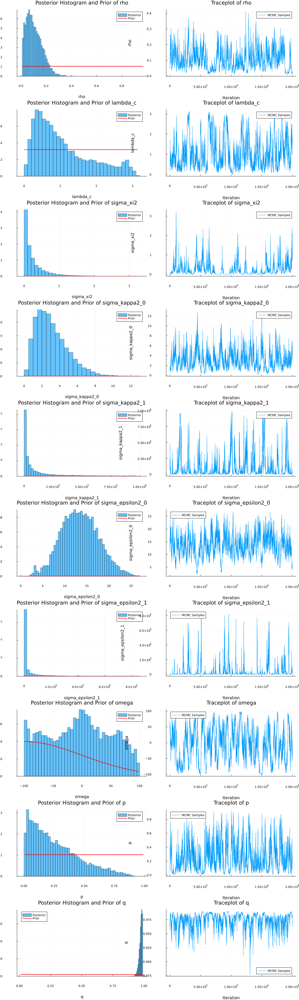

In [59]:
# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    param_samples = theta_samples_burned[:, i]
    # param_samples = theta_samples_init[:,i]
    
    # Histogram of posterior samples
    p1 = histogram(param_samples, bins=50, normalize=true, alpha=0.6,
                   label="Posterior", xlabel=parameters[i], ylabel="Density",
                   title="Posterior Histogram and Prior of $(parameters[i])")
    
    # Define the prior distribution
    if parameters[i] == "rho"
        # Uniform prior between 0 and 0.999
        a = a_rho
        b = b_rho
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "lambda_c"
        # Uniform prior between 0 and π
        a = a_lambda
        b = b_lambda
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] in ["p", "q"]
        # Uniform prior between 0 and 1
        a = a_p
        b = 1b_p
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "omega"
        a = a_omega
        b = b_omega
        x_values = range(minimum(param_samples), maximum(param_samples), length=200)
        prior_pdf = pdf.(Normal(a, b), x_values)
    elseif parameters[i] == "sigma_xi2"
        a = a_xi
        b = b_xi
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_0"
        a = a_kappa_0
        b = b_kappa_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_1"
        a = a_kappa_1
        b = b_kappa_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2_0"
        a = a_epsilon_0
        b = b_epsilon_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2_1"
        a = a_epsilon_1
        b = b_epsilon_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_y"
        a = a_sigma
        b = b_sigma
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    
    end
    
    # Overlay prior PDF on histogram
    plot!(p1, x_values, prior_pdf, label="Prior", color=:red, linewidth=2)

    #MLE estimates
    # vline!(p1, [best_params[i]], label="MLE", color=:blue, linestyle=:dashdot, linewidth=2)
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")
    
 
    
    # Add plots to the list
    push!(p_list, p1)
    push!(p_list, p2)
end

# Display the plots in a grid layout
nrows = n_params
ncols = 2
recursion_plot = plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))

savefig(recursion_plot, "Harvey_in_Kim_estimation.png")

display(recursion_plot)

In [60]:
# Calculate means of posterior samples
chain_rec_burned_means = mean(theta_samples_burned, dims=1)  # 1 x n_params array
chain_rec_burned_means = vec(chain_rec_burned_means)  # Convert to a vector


10-element Vector{Float64}:
      0.10535136210780843
      1.0623157214489594
      0.2598237134032687
      3.1106664455238784
 110490.6757930454
     13.412604739755153
  37918.12234499537
     -4.480334232600659
      0.2589049766230566
      0.9735180731011475

In [61]:

# Create the DataFrame
data = DataFrame(Dict(
    "Parameter" => parameters,
    "MCMC Estimate" => chain_rec_burned_means,
    "MLE Estimate" => best_params,  # Include if available
))

# Display the DataFrame
display(data)


Row,MCMC Estimate,MLE Estimate,Parameter
,Float64,Float64,String
1,0.105351,0.566651,rho
2,1.06232,2.85834,lambda_c
3,0.259824,5.87973e-12,sigma_xi2
4,3.11067,0.0905024,sigma_kappa2_0
5,1.10491e5,5.43709e-9,sigma_kappa2_1
6,13.4126,10.2164,sigma_epsilon2_0
7,37918.1,86.7427,sigma_epsilon2_1
8,-4.48033,-10.3991,omega
9,0.258905,0.956797,p


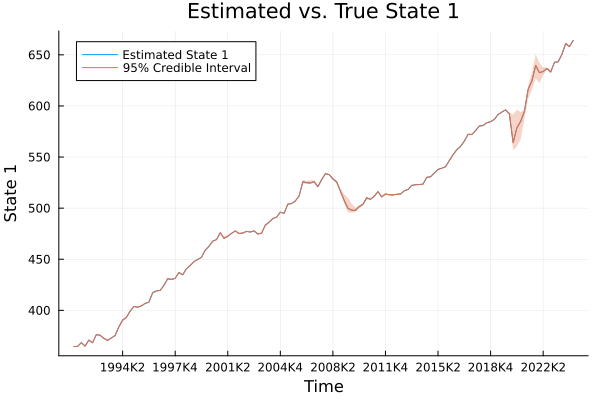

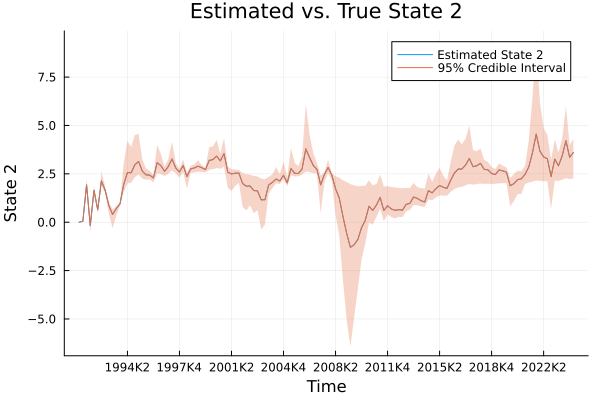

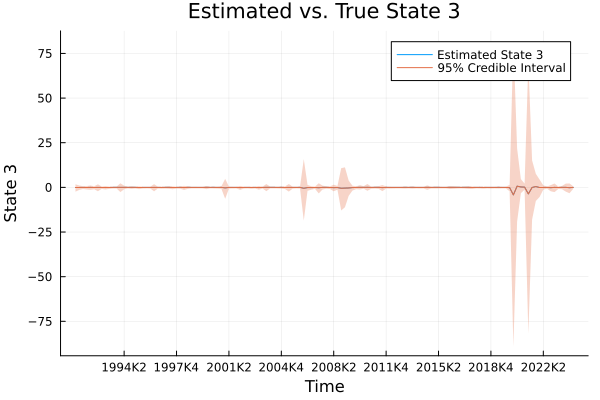

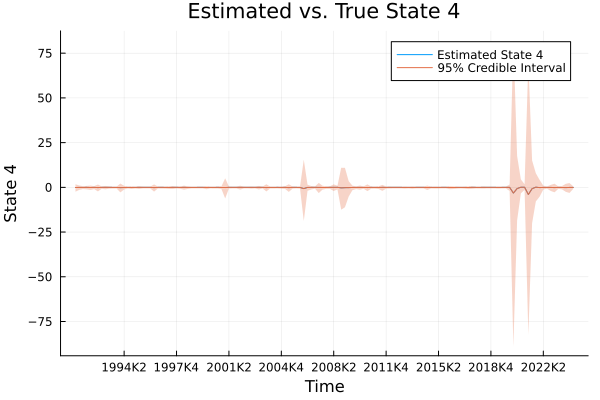

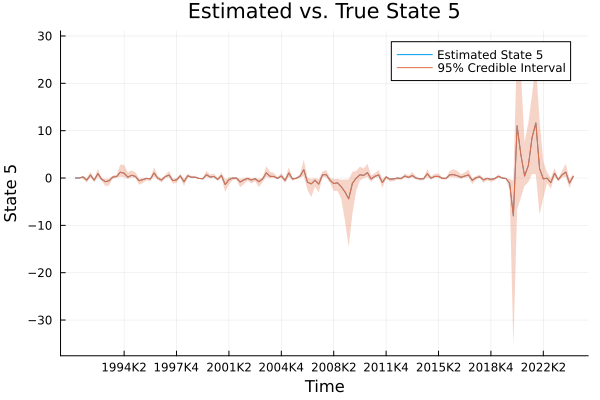

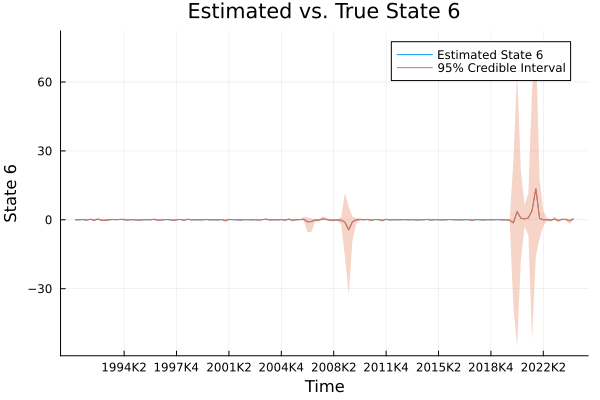

In [62]:
# Collect alpha samples into a 3D array
n_samples = length(alpha_samples)
n_time_steps = size(alpha_samples[1], 1)
state_dim = size(alpha_samples[1], 2)

dates_plot = dates

println(n_time_steps)
println(length(dates_plot))

# Initialize array to hold alpha samples
alpha_samples_array = Array{Float64}(undef, n_samples, n_time_steps, state_dim)

for i in 1:n_samples
    alpha_samples_array[i, :, :] = alpha_samples[i]
end


# Compute posterior mean over samples (dimension 1)
alpha_mean = mean(alpha_samples_array, dims=1)  # 1 x n_time_steps x state_dim
alpha_mean = dropdims(alpha_mean; dims=1)  # n_time_steps x state_dim

# Compute credible intervals
alpha_lower = mapslices(x -> quantile(x, 0.025), alpha_samples_array; dims=1)
alpha_lower = dropdims(alpha_lower; dims=1)
alpha_upper = mapslices(x -> quantile(x, 0.975), alpha_samples_array; dims=1)
alpha_upper = dropdims(alpha_upper; dims=1)



time = 1:n_time_steps

for s in 1:state_dim
    p = plot(dates_plot, alpha_mean[:, s], label="Estimated State $(s)", xlabel="Time",
             ylabel="State $(s)", title="Estimated vs. True State $(s)")
    
    # Add credible intervals using the `ribbon` argument
    plot!(dates_plot, alpha_mean[:, s], ribbon=(alpha_mean[:, s] .- alpha_lower[:, s],
          alpha_upper[:, s] .- alpha_mean[:, s]), fillalpha=0.3, label="95% Credible Interval")
    
    # # Plot true state (assuming you have `alpha_true` from data simulation)
    # plot!(time, alpha[1:n_time_steps, s], label="True State $(s)", linestyle=:dash, color=:red)
    
    display(p)
end


In [63]:
using JLD2

# Save the states to a JLD2 file
@save "states_harvey_in_kim.jld2" alpha_mean alpha_lower alpha_upper



ArgumentError: ArgumentError: Package JLD2 not found in current path.
- Run `import Pkg; Pkg.add("JLD2")` to install the JLD2 package.

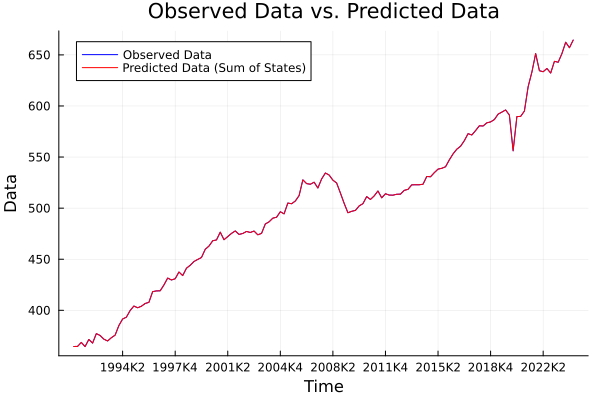

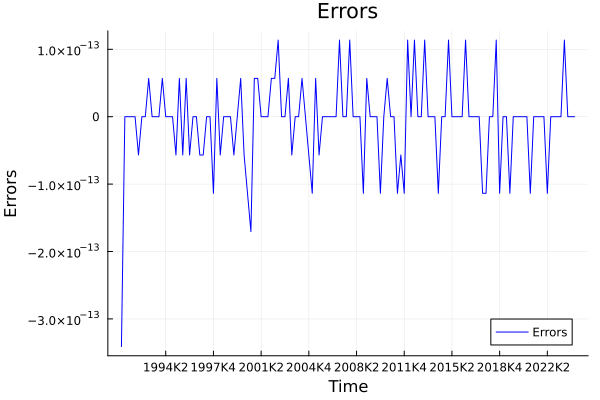

In [64]:
# Compute y_pred
state_indices = [1, 2+2*n_order-1]  

y_pred = alpha_mean[:, state_indices[1]] .+ alpha_mean[:, state_indices[2]]

time = 1:length(y_pred)
y_adjusted = y

p = plot(dates_plot, y_adjusted, label="Observed Data", color=:blue)
plot!(p, dates_plot, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted Data")
display(p)


errors = y_adjusted .- y_pred

p_error = plot(dates_plot, errors, label="Errors", color=:blue)
xlabel!("Time")
ylabel!("Errors")
title!("Errors")
display(p_error)


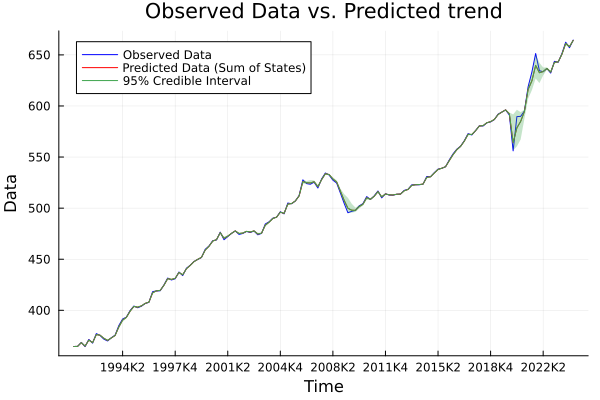

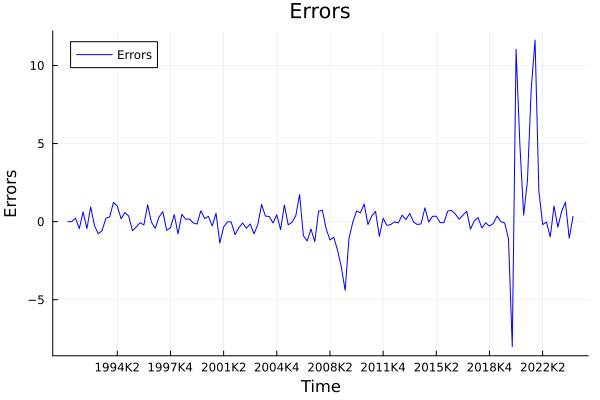

In [65]:
# estimated state 1 and true observation y
# Compute y_pred
state_indices = [1, 2+2*n_order-1]  

y_pred = alpha_mean[:, state_indices[1]] 

time = 1:length(y_pred)
y_adjusted = y[1:length(y_pred)]  # Adjust if lengths differ

p = plot(dates_plot, y_adjusted, label="Observed Data", color=:blue)
plot!(p, dates_plot, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted trend")
# Add credible intervals using the `ribbon` argument
plot!(dates_plot, y_pred, ribbon=(alpha_mean[:, state_indices[1]] .- alpha_lower[:, state_indices[1]],
      alpha_upper[:, state_indices[1]] .- alpha_mean[:, state_indices[1]]), fillalpha=0.3, label="95% Credible Interval")
display(p)


errors = y_adjusted .- y_pred

p_error = plot(dates_plot, errors, label="Errors", color=:blue)
xlabel!("Time")
ylabel!("Errors")
title!("Errors")
display(p_error)





### Probability of being in recesion

In [66]:
#print shape p_res

println(size(p_res[1]))

In [67]:
# Initialize array to hold p_res samples
n_p_res = length(p_res)
n_time_steps = size(p_res[1], 1)
dim_res = size(p_res[1], 2)
p_res_array = Array{Float64}(undef, n_p_res, n_time_steps, dim_res)

for i in 1:n_samples
    p_res_array[i, :, :] = p_res[i]
end

p_res_array_mean = mean(p_res_array, dims=1)  # 1 x n_time_steps x dim_res


p_res_mean = p_res_array_mean[1,:,2]

#save p_res_mean to a file
@save "p_res_mean_harvey_in_kim.jld2" p_res_mean


LoadError: LoadError: UndefVarError: `@save` not defined in `Main`
Suggestion: check for spelling errors or missing imports.
in expression starting at c:\Users\wrc938\OneDrive - University of Copenhagen\Økonomi\9. semester\Empirical macro\State-Space-Model-Estimation-1\Switching\Harvey in Kim Nelson\jl_notebook_cell_df34fa98e69747e1a8f8a730347b8e2f_X26sZmlsZQ==.jl:17

## Graphs from MLE estimates


In [68]:
logL, a_mle, p_res_mle = switching_kalman_filter(y, best_params, n_order, alpha_init, P1)

(-409.1693563940245, [364.6 0.0 … 0.0 0.0; 366.01374933221723 0.4587194118404341 … -1.313749332217272 -1.9580857401221172; … ; 661.6633514287255 2.36223844142543 … -4.6633514287254165 -3.436947189554397; 667.113743015472 2.3753169609373272 … -2.6137430154719903 -0.6413382813655286], [0.778748789860863 0.2212512101391369; 0.8030707955216609 0.1969292044783391; … ; 0.19036942208477908 0.809630577915221; 0.4004326269194325 0.5995673730805675])

In [69]:
println(size(a_mle))

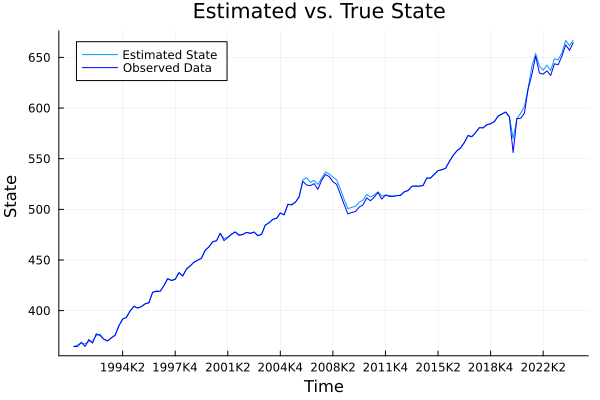

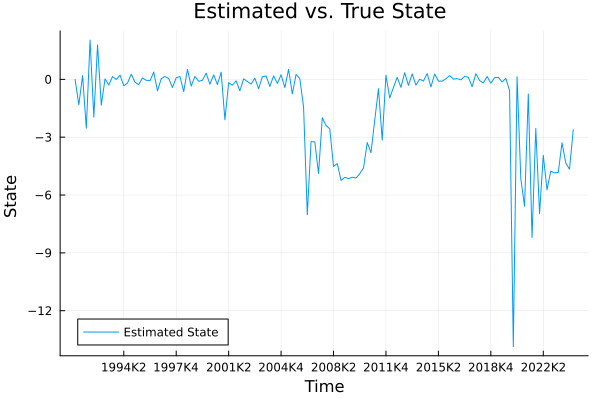

In [70]:
# Collect alpha samples into a 3D array
n_time_steps = size(alpha_samples[1])
state_dim = size(alpha_samples[2])

dates_plot = dates

p = plot(dates_plot, a_mle[:,1], label="Estimated State ", xlabel="Time",
             ylabel="State ", title="Estimated vs. True State ")

        # add y
        plot!(dates_plot, y, label="Observed Data", color=:blue)
    
    
display(p)

p = plot(dates_plot, a_mle[:,2+2*n_order-1], label="Estimated State ", xlabel="Time",
             ylabel="State ", title="Estimated vs. True State ")
display(p)

    

